In [102]:
# Dependencies and Setup
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import requests
import gmaps
import os
import datetime

# File to Load 
satellite_data = "resources/UCS-Satellite-Database-8-1-2020.csv"


# Read satellite data file and store into Pandas DataFrames
satellite_df = pd.read_csv(satellite_data)


# View Data
satellite_df

,"Name of Satellite, Alternate Names",Current Official Name of Satellite,Country/Org of UN Registry,Country of Operator/Owner,Operator/Owner,Users,Purpose,Detailed Purpose,Class of Orbit,Type of Orbit,Longitude of GEO (degrees),Perigee (km),Apogee (km),Eccentricity,Inclination (degrees),Period (minutes),Launch Mass (kg.),Dry Mass (kg.),Power (watts),Date of Launch,Expected Lifetime (yrs.),Contractor,Country of Contractor,Launch Site,Launch Vehicle,COSPAR Number,NORAD Number,Comments,Unnamed: 28,Source Used for Orbital Data,Source,Unnamed: 31,Source.1,Source.2,Source.3,Source.4,Source.5,Unnamed: 37,Unnamed: 38,Unnamed: 39,Unnamed: 40,Unnamed: 41,Unnamed: 42,Unnamed: 43,Unnamed: 44,Unnamed: 45,Unnamed: 46,Unnamed: 47,Unnamed: 48,Unnamed: 49,Unnamed: 50,Unnamed: 51,Unnamed: 52,Unnamed: 53,Unnamed: 54,Unnamed: 55,Unnamed: 56,Unnamed: 57,Unnamed: 58,Unnamed: 59,Unnamed: 60,Unnamed: 61,Unnamed: 62,Unnamed: 63,Unnamed: 64,Unnamed: 65,Unnamed: 66
0,1HOPSAT-TD (1st-generation High Optical Perfor...,1HOPSAT,NR (3/20),USA,Hera Systems,Commercial,Earth Observation,Technology Development,LEO,Non-Polar Inclined,0.00,566,576,0.000720,36.90,96.08,22,NaN,NaN,12/11/2019,0.50,Hera Systems,USA,Satish Dhawan Space Centre,PSLV,2019-089H,44859,Pathfinder for planned earth observation const...,NaN,JMSatcat/3_20,https://spaceflightnow.com/2019/12/11/indias-5...,https://www.herasys.com/,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,3Cat-1,3Cat-1,NR,Spain,Universitat Politècnica de Catalunya,Civil,Technology Development,NaN,LEO,NaN,0.00,476,500,0.001750,97.40,95,4,NaN,NaN,11/29/2018,NaN,Universitat Politècnica de Catalunya,Spain,Satish Dhawan Space Centre,PSLV,2018-096K,43728,Student built.,NaN,Estimated,https://spaceflightnow.com/2018/11/29/indian-r...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Aalto-1,Aalto-1,Finland,Finland,Aalto University,Civil,Technology Development,NaN,LEO,NaN,0.00,497,517,0.001450,97.45,94.7,5,NaN,4.5,6/23/2017,2.00,Aalto University,Finland,Satish Dhawan Space Centre,PSLV,2017-036L,42775,Technology development and education.,NaN,JMSatcat/10_17,https://directory.eoportal.org/web/eoportal/sa...,NaN,http://www.planet4589.org/space/log/satcat.txt,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,AAUSat-4,AAUSat-4,Denmark,Denmark,University of Aalborg,Civil,Earth Observation,Automatic Identification System (AIS),LEO,Sun-Synchronous,0.00,442,687,0.017700,98.20,95.9,1,NaN,NaN,4/25/2016,NaN,University of Aalborg,Denmark,Guiana Space Center,Soyuz 2.1a,2016-025E,41460,Carries AIS system.,NaN,Space50,http://spaceflightnow.com/2016/04/26/soyuz-bla...,NaN,http://space50.org/objekt.php?mot=2016-025E&ja...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,"ABS-2 (Koreasat-8, ST-3)",ABS-2,NR,Multinational,Asia Broadcast Satellite Ltd.,Commercial,Communications,NaN,GEO,NaN,75.00,"35,778","35,793",0.000178,0.08,1436.03,"6,330",NaN,"16,000",2/6/2014,15.00,Space Systems/Loral,USA,Guiana Space Center,Ariane 5 ECA,2014-006A,39508,"32 C-band, 51 Ku-band, and 6 Ka-band transpond...",NaN,ZARYA,http://www.absatellite.net/satellite-fleet/?sa...,NaN,http://www.zarya.info/Diaries/Launches/Launche...,http://www.absatellite.net/2010/10/13/asia-bro...,http://www.spacenews.com/article/satellite-tel...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,ABS-2A,ABS-2A,NR,Multinational,Asia Broadcast Satellite Ltd.,Commercial,Communications,NaN,GEO,NaN,-75.00,"35,700","35,700",0.000000,0.00,1436.1,"1,800",NaN,NaN,6/15/2016,15.00,Boeing Satellite Systems,USA,Cape Canaveral,Falcon 9,2016-038A,41588,NaN,NaN,Estimated,NaN,N

In [104]:
# Drop duplicate satellite names column. Only using current official satellite name
cleaned_data = satellite_df.drop(columns =['Name of Satellite, Alternate Names'])
cleaned_data = cleaned_data.drop(columns = ['Unnamed: 28' , 'Unnamed: 31'])


#Drop Unnamed columns
col_index = 37
for x in range(30):
    cleaned_data = cleaned_data.drop(columns = [f'Unnamed: ' + str(col_index) ])    
    col_index = col_index + 1
    

In [105]:
# Remove sources columns
cleaned_data = cleaned_data.drop(columns = ['Source'])

source_index = 1
for x in range(5):
    cleaned_data = cleaned_data.drop(columns = [f'Source.' + str(source_index) ])    
    source_index = source_index + 1

cleaned_data

,Current Official Name of Satellite,Country/Org of UN Registry,Country of Operator/Owner,Operator/Owner,Users,Purpose,Detailed Purpose,Class of Orbit,Type of Orbit,Longitude of GEO (degrees),Perigee (km),Apogee (km),Eccentricity,Inclination (degrees),Period (minutes),Launch Mass (kg.),Dry Mass (kg.),Power (watts),Date of Launch,Expected Lifetime (yrs.),Contractor,Country of Contractor,Launch Site,Launch Vehicle,COSPAR Number,NORAD Number,Comments,Source Used for Orbital Data
0,1HOPSAT,NR (3/20),USA,Hera Systems,Commercial,Earth Observation,Technology Development,LEO,Non-Polar Inclined,0.00,566,576,0.000720,36.90,96.08,22,NaN,NaN,12/11/2019,0.50,Hera Systems,USA,Satish Dhawan Space Centre,PSLV,2019-089H,44859,Pathfinder for planned earth observation const...,JMSatcat/3_20
1,3Cat-1,NR,Spain,Universitat Politècnica de Catalunya,Civil,Technology Development,NaN,LEO,NaN,0.00,476,500,0.001750,97.40,95,4,NaN,NaN,11/29/2018,NaN,Universitat Politècnica de Catalunya,Spain,Satish Dhawan Space Centre,PSLV,2018-096K,43728,Student built.,Estimated
2,Aalto-1,Finland,Finland,Aalto University,Civil,Technology Development,NaN,LEO,NaN,0.00,497,517,0.001450,97.45,94.7,5,NaN,4.5,6/23/2017,2.00,Aalto University,Finland,Satish Dhawan Space Centre,PSLV,2017-036L,42775,Technology development and education.,JMSatcat/10_17
3,AAUSat-4,Denmark,Denmark,University of Aalborg,Civil,Earth Observation,Automatic Identification System (AIS),LEO,Sun-Synchronous,0.00,442,687,0.017700,98.20,95.9,1,NaN,NaN,4/25/2016,NaN,University of Aalborg,Denmark,Guiana Space Center,Soyuz 2.1a,2016-025E,41460,Carries AIS system.,Space50
4,ABS-2,NR,Multinational,Asia Broadcast Satellite Ltd.,Commercial,Communications,NaN,GEO,NaN,75.00,"35,778","35,793",0.000178,0.08,1436.03,"6,330",NaN,"16,000",2/6/2014,15.00,Space Systems/Loral,USA,Guiana Space Center,Ariane 5 ECA,2014-006A,39508,"32 C-band, 51 Ku-band, and 6 Ka-band transpond...",ZARYA
5,ABS-2A,NR,Multinational,Asia Broadcast Satellite Ltd.,Commercial,Communications,NaN,GEO,NaN,-75.00,"35,700","35,700",0.000000,0.00,1436.1,"1,800",NaN,NaN,6/15/2016,15.00,Boeing Satellite Systems,USA,Cape Canaveral,Falcon 9,2016-038A,41588,NaN,Estimated
6,ABS-3A,NR,Multinational,Asia Broadcast Satellite Ltd.,Commercial,Communications,NaN,GEO,NaN,-3.00,"35,788","35,803",0.000178,0.10,1436,"2,000",NaN,NaN,3/2/2015,15.00,Boeing Satellite Systems,USA,Cape Canaveral,Falcon 9,2015-010A,40424,Coverage of Americas Europe and Africa.,NaN
7,ABS-4,NR,Multinational,Asia Broadcast Satellite Ltd.,Commercial,Communications,NaN,GEO,NaN,75.00,"35,780","35,793",0.000154,0.01,1436.1,"4,143","1,700","7,400",3/13/2004,12.00,Space Systems/Loral,USA,Cape Canaveral,Atlas 3,2004-007A,28184,Purchased by ABS in 2013.,JM/12_08
8,ABS-6,NR,Multinational,Asia Broadcast Satellite Ltd.,Commercial,Communications,NaN,GEO,NaN,159.00,"35,777","35,794",0.000202,0.01,1436.08,"2,894","1,730","6,800 (EOL)",9/26/1999,15.00,Lockheed Martin,USA,Baikonur Cosmodrome,Proton,1999-053A,25924,"28 C-band, 16 Ku-band; business services, publ...",JM/12_08
9,ABS-7,South Korea,Multinational,Asia Broadcast Satellite Ltd.,Commercial,Communications,NaN,GEO,NaN,116.18,"35,780","35,791",0.000130,0.01,1436.06,"3,500","1,800","4,800",9/4/1999,15.00,Lockheed Martin Astro Space,USA,Guiana Space Center,Ariane,1999-046A,25894,"30 Ku-band, 6 Ka-band; Korean peninsula, the J...",JM/12_08


In [107]:
#Add a column with the launch year extraceted from launch date

cleaned_data['Launch Year'] = pd.DatetimeIndex(cleaned_data['Date of Launch']).year


In [108]:
#Replace NA values in Expected Lifetime with 0 for easier analysis

cleaned_data[['Expected Lifetime (yrs.)']] = cleaned_data[['Expected Lifetime (yrs.)']].fillna(value=0)
cleaned_data['Expected Lifetime (yrs.)'] = cleaned_data['Expected Lifetime (yrs.)'].astype(float)
cleaned_data['Launch Year'] = cleaned_data['Launch Year'].astype(int)
cleaned_data[['Detailed Purpose']] = cleaned_data[['Detailed Purpose']].fillna(value='Unknown')
cleaned_data[['Type of Orbit']] = cleaned_data[['Type of Orbit']].fillna(value='Unknown')
cleaned_data[['Comments']] = cleaned_data[['Comments']].fillna(value='Unknown')


#View final cleaned dataframe
cleaned_data.head()

,Current Official Name of Satellite,Country/Org of UN Registry,Country of Operator/Owner,Operator/Owner,Users,Purpose,Detailed Purpose,Class of Orbit,Type of Orbit,Longitude of GEO (degrees),Perigee (km),Apogee (km),Eccentricity,Inclination (degrees),Period (minutes),Launch Mass (kg.),Dry Mass (kg.),Power (watts),Date of Launch,Expected Lifetime (yrs.),Contractor,Country of Contractor,Launch Site,Launch Vehicle,COSPAR Number,NORAD Number,Comments,Source Used for Orbital Data,Launch Year
0,1HOPSAT,NR (3/20),USA,Hera Systems,Commercial,Earth Observation,Technology Development,LEO,Non-Polar Inclined,0.0,566,576,0.000720,36.90,96.08,22,NaN,NaN,12/11/2019,0.5,Hera Systems,USA,Satish Dhawan Space Centre,PSLV,2019-089H,44859,Pathfinder for planned earth observation const...,JMSatcat/3_20,2019
1,3Cat-1,NR,Spain,Universitat Politècnica de Catalunya,Civil,Technology Development,Unknown,LEO,Unknown,0.0,476,500,0.001750,97.40,95,4,NaN,NaN,11/29/2018,0.0,Universitat Politècnica de Catalunya,Spain,Satish Dhawan Space Centre,PSLV,2018-096K,43728,Student built.,Estimated,2018
2,Aalto-1,Finland,Finland,Aalto University,Civil,Technology Development,Unknown,LEO,Unknown,0.0,497,517,0.001450,97.45,94.7,5,NaN,4.5,6/23/2017,2.0,Aalto University,Finland,Satish Dhawan Space Centre,PSLV,2017-036L,42775,Technology development and education.,JMSatcat/10_17,2017
3,AAUSat-4,Denmark,Denmark,University of Aalborg,Civil,Earth Observation,Automatic Identification System (AIS),LEO,Sun-Synchronous,0.0,442,687,0.017700,98.20,95.9,1,NaN,NaN,4/25/2016,0.0,University of Aalborg,Denmark,Guiana Space Center,Soyuz 2.1a,2016-025E,41460,Carries AIS system.,Space50,2016
4,ABS-2,NR,Multinational,Asia Broadcast Satellite Ltd.,Commercial,Communications,Unknown,GEO,Unknown,75.0,"35,778","35,793",0.000178,0.08,1436.03,"6,330",NaN,"16,000",2/6/2014,15.0,Space Systems/Loral,USA,Guiana Space Center,Ariane 5 ECA,2014-006A,39508,"32 C-band, 51 Ku-band, and 6 Ka-band transpond...",ZARYA,2014


In [109]:
# Save as a csv
# Note to avoid any issues later, use encoding="utf-8"

cleaned_data.to_csv("resources/cleaned_data.csv", encoding="utf-8", index=False)

In [110]:
#Use this cell to load data for plotting and analysis

# File to Load 
cleaned_satellite_data = "resources/cleaned_data.csv"


# Read satellite data file and store into Pandas DataFrames
cleaned_satellite_df = pd.read_csv(cleaned_satellite_data)


# View Data
# Note columns in middle not displayed due to size limitation on pandas display. 

cleaned_satellite_df


,Current Official Name of Satellite,Country/Org of UN Registry,Country of Operator/Owner,Operator/Owner,Users,Purpose,Detailed Purpose,Class of Orbit,Type of Orbit,Longitude of GEO (degrees),Perigee (km),Apogee (km),Eccentricity,Inclination (degrees),Period (minutes),Launch Mass (kg.),Dry Mass (kg.),Power (watts),Date of Launch,Expected Lifetime (yrs.),Contractor,Country of Contractor,Launch Site,Launch Vehicle,COSPAR Number,NORAD Number,Comments,Source Used for Orbital Data,Launch Year
0,1HOPSAT,NR (3/20),USA,Hera Systems,Commercial,Earth Observation,Technology Development,LEO,Non-Polar Inclined,0.00,566,576,0.000720,36.90,96.08,22,NaN,NaN,12/11/2019,0.50,Hera Systems,USA,Satish Dhawan Space Centre,PSLV,2019-089H,44859,Pathfinder for planned earth observation const...,JMSatcat/3_20,2019
1,3Cat-1,NR,Spain,Universitat Politècnica de Catalunya,Civil,Technology Development,Unknown,LEO,Unknown,0.00,476,500,0.001750,97.40,95,4,NaN,NaN,11/29/2018,0.00,Universitat Politècnica de Catalunya,Spain,Satish Dhawan Space Centre,PSLV,2018-096K,43728,Student built.,Estimated,2018
2,Aalto-1,Finland,Finland,Aalto University,Civil,Technology Development,Unknown,LEO,Unknown,0.00,497,517,0.001450,97.45,94.7,5,NaN,4.5,6/23/2017,2.00,Aalto University,Finland,Satish Dhawan Space Centre,PSLV,2017-036L,42775,Technology development and education.,JMSatcat/10_17,2017
3,AAUSat-4,Denmark,Denmark,University of Aalborg,Civil,Earth Observation,Automatic Identification System (AIS),LEO,Sun-Synchronous,0.00,442,687,0.017700,98.20,95.9,1,NaN,NaN,4/25/2016,0.00,University of Aalborg,Denmark,Guiana Space Center,Soyuz 2.1a,2016-025E,41460,Carries AIS system.,Space50,2016
4,ABS-2,NR,Multinational,Asia Broadcast Satellite Ltd.,Commercial,Communications,Unknown,GEO,Unknown,75.00,"35,778","35,793",0.000178,0.08,1436.03,"6,330",NaN,"16,000",2/6/2014,15.00,Space Systems/Loral,USA,Guiana Space Center,Ariane 5 ECA,2014-006A,39508,"32 C-band, 51 Ku-band, and 6 Ka-band transpond...",ZARYA,2014
5,ABS-2A,NR,Multinational,Asia Broadcast Satellite Ltd.,Commercial,Communications,Unknown,GEO,Unknown,-75.00,"35,700","35,700",0.000000,0.00,1436.1,"1,800",NaN,NaN,6/15/2016,15.00,Boeing Satellite Systems,USA,Cape Canaveral,Falcon 9,2016-038A,41588,Unknown,Estimated,2016
6,ABS-3A,NR,Multinational,Asia Broadcast Satellite Ltd.,Commercial,Communications,Unknown,GEO,Unknown,-3.00,"35,788","35,803",0.000178,0.10,1436,"2,000",NaN,NaN,3/2/2015,15.00,Boeing Satellite Systems,USA,Cape Canaveral,Falcon 9,2015-010A,40424,Coverage of Americas Europe and Africa.,NaN,2015
7,ABS-4,NR,Multinational,Asia Broadcast Satellite Ltd.,Commercial,Communications,Unknown,GEO,Unknown,75.00,"35,780","35,793",0.000154,0.01,1436.1,"4,143","1,700","7,400",3/13/2004,12.00,Space Systems/Loral,USA,Cape Canaveral,Atlas 3,2004-007A,28184,Purchased by ABS in 2013.,JM/12_08,2004
8,ABS-6,NR,Multinational,Asia Broadcast Satellite Ltd.,Commercial,Communications,Unknown,GEO,Unknown,159.00,"35,777","35,794",0.000202,0.01,1436.08,"2,894","1,730","6,800 (EOL)",9/26/1999,15.00,Lockheed Martin,USA,Baikonur Cosmodrome,Proton,1999-053A,25924,"28 C-band, 16 Ku-band; business services, publ...",JM/12_08,1999
9,ABS-7,South Korea,Multinational,Asia Broadcast Satellite Ltd.,Commercial,Communications,Unknown,GEO,Unknown,116.18,"35,780","35,791",0.000130,0.01,1436.06,"3,500","1,800","4,800",9/4/1999,15.00,Lockheed Martin Astro Space,USA,Guiana Space Center,Ariane,1999-046A,25894,"30 Ku-band, 6 Ka-band; Korean peninsula, the J...",JM/12_08,1999


In [111]:
pd.options.display.max_columns=None
pd.options.display.max_rows=None

In [112]:
#How many satellites does a given country have in orbit, and what are they used for?
orbit_countries = cleaned_satellite_df['Country of Operator/Owner'].value_counts()
orbit_countries

USA                                  1406
China                                 375
Russia                                170
United Kingdom                        129
Japan                                  80
Multinational                          64
India                                  58
ESA                                    53
Canada                                 39
Germany                                33
Luxembourg                             32
Spain                                  21
South Korea                            17
Israel                                 16
Argentina                              16
Australia                              13
Saudi Arabia                           13
Netherlands                            12
Italy                                  12
France                                 12
Taiwan/USA                             11
Brazil                                 11
Indonesia                               9
Singapore                         

In [121]:
country_purpose = cleaned_satellite_df[['Country of Operator/Owner', 'Purpose']] 
country_purpose


,Country of Operator/Owner,Purpose
0,USA,Earth Observation
1,Spain,Technology Development
2,Finland,Technology Development
3,Denmark,Earth Observation
4,Multinational,Communications
5,Multinational,Communications
6,Multinational,Communications
7,Multinational,Communications
8,Multinational,Communications
9,Multinational,Communications


In [123]:
%%HTML
<style type="text/css">
table.dataframe td, table.dataframe th {
    border: 1px  black solid !important;
  color: black !important;
}
</style>


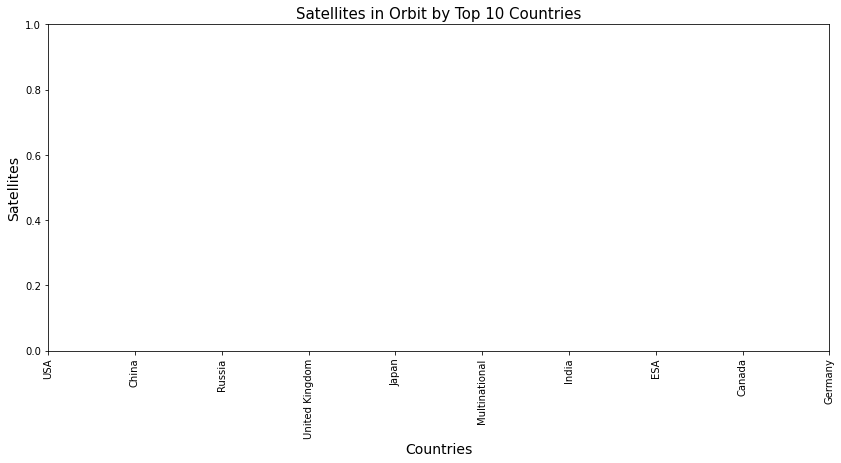

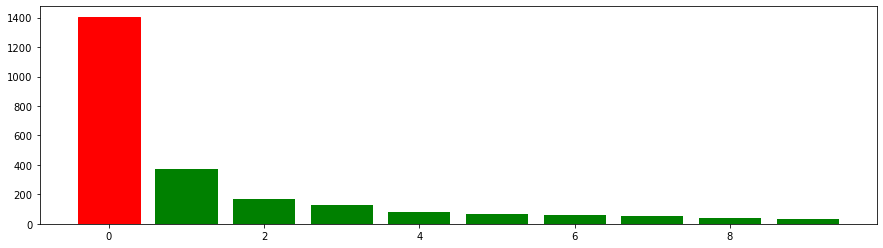

In [151]:
#satellites by top 10 countries for bar chart 

countries = ["USA", "China", "Russia","United Kingdom", "Japan", "Multinational", "India", "ESA", "Canada", "Germany"]
satellites = [1406, 375, 170, 129, 80, 64, 58, 53, 39, 33]
x_axis = np.arange(len(satellites))
y_axis = np.arange(len(countries))

fig, ax = plt.subplots(figsize=(14,6))
plt.bar(x_axis, satellites, color="g", align="center")


tick_locations = [value for value in x_axis]
plt.xticks(tick_locations, countries, size= 10, rotation=90)

plt.title("Satellites in Orbit by Top 10 Countries", fontsize=15)
plt.xlabel("Countries", fontsize=14)
plt.ylabel("Satellites", fontsize=14)
plt.figure(figsize = (15, 4))
plt.savefig("SatellitesinOrbit.png")

plt.bar(x_axis, satellites, color="g", align="center")



plt.show()

In [124]:
#extracted satellites used solely for military
military_use_defined = cleaned_satellite_df[(cleaned_satellite_df['Users'] == 'Military')]
military_use_defined


,Current Official Name of Satellite,Country/Org of UN Registry,Country of Operator/Owner,Operator/Owner,Users,Purpose,Detailed Purpose,Class of Orbit,Type of Orbit,Longitude of GEO (degrees),Perigee (km),Apogee (km),Eccentricity,Inclination (degrees),Period (minutes),Launch Mass (kg.),Dry Mass (kg.),Power (watts),Date of Launch,Expected Lifetime (yrs.),Contractor,Country of Contractor,Launch Site,Launch Vehicle,COSPAR Number,NORAD Number,Comments,Source Used for Orbital Data,Launch Year
10,USA 139,USA,USA,National Reconnaissance Office (NRO),Military,Earth Observation,Electronic Intelligence,GEO,Unknown,-26.00,"35,560","36,013",0.005370,7.72,1436.14,"4,500",NaN,NaN,5/9/1998,0.0,TRW Space and Electronics,USA,Cape Canaveral,Titan IVA,1998-029A,25336,ELINT.,JM/12_08,1998
11,USA 171,USA,USA,National Reconnaissance Office (NRO),Military,Earth Observation,Electronic Intelligence,GEO,Unknown,95.40,"35,589","35,984",0.004680,3.20,1436.1,"4,500",NaN,NaN,9/9/2003,0.0,TRW Space and Electronics,USA,Cape Canaveral,Titan IV,2003-041A,27937,Electronic intelligence (ELINT).,JM/12_08,2003
12,USA 202,USA,USA,National Reconnaissance Office (NRO),Military,Earth Observation,Electronic Intelligence,GEO,Unknown,44.00,"35,714","35,937",0.002640,2.89,1438.8,"5,000",NaN,NaN,1/18/2009,0.0,National Reconnaissance Laboratory (?),USA,Cape Canaveral,Delta 4 Heavy,2009-001A,33490,ELINT.,SC - ASCR,2009
13,USA 223,USA,USA,National Reconnaissance Office (NRO),Military,Earth Observation,Electronic Intelligence,GEO,Unknown,100.90,"35,500","35,500",0.000000,0.00,1436,"5,000",NaN,NaN,11/21/2010,0.0,National Reconnaissance Laboratory (?),USA,Cape Canaveral,Delta 4 Heavy,2010-063A,37232,ELINT.,SC - ASCR,2010
14,USA 237,USA,USA,National Reconnaissance Office (NRO),Military,Earth Observation,Electronic Intelligence,GEO,Unknown,60.00,"35,771","35,805",0.000403,0.00,1436.1,"5,000",NaN,NaN,6/29/2012,0.0,National Reconnaissance Laboratory (?),USA,Cape Canaveral,Delta 4 Heavy,2012-034A,38528,ELINT.,CalSky,2012
15,USA 268,USA,USA,National Reconnaissance Office (NRO),Military,Earth Observation,Electronic Intelligence,GEO,Unknown,102.60,"35,613","35,903",0.003440,7.51,1437.19,"5,000",NaN,NaN,6/11/2016,0.0,National Reconnaissance Laboratory (?),USA,Cape Canaveral,Delta 4 Heavy,2016-036A,41584,ELINT.,ZARYA,2016
16,USA 235,USA,USA,US Air Force,Military,Communications,Unknown,GEO,Unknown,-120.00,"35,772","35,801",0.000344,2.34,1436.1,"6,169",NaN,NaN,5/3/2012,14.0,Lockheed Martin Space Systems,USA,Cape Canaveral,Atlas 5,2012-019A,38254,Second in constellation.,ZARYA,2012
17,USA 246,NR,USA,US Air Force,Military,Communications,Unknown,GEO,Unknown,152.10,"35,700","35,803",0.001220,4.20,1436.1,"6,169",NaN,NaN,9/18/2013,14.0,Lockheed Martin Space Systems,USA,Cape Canaveral,Atlas 5,2013-050A,39256,Third in constellation.,ZARYA,2013
18,USA 288,USA,USA,US Air Force,Military,Communications,Unknown,GEO,Unknown,150.20,"35,781","35,790",0.000107,0.05,1436.1,"6,169",NaN,NaN,10/17/2018,0.0,Lockheed Martin Space Systems,USA,Cape Canaveral,Atlas 5,2018-079A,43651,Unknown,JMGEO/11_19),2018
19,USA 292,USA,USA,US Air Force,Military,Communications,Unknown,GEO,Unknown,-94.39,"35,780","35,810",0.000356,6.40,1436.2,"6,169",NaN,NaN,8/8/2019,0.0,Lockheed Martin Space Systems,USA,Cape Canaveral,Atlas 5,2019-051A,44481,Unknown,JMGEO/11_19),2019


In [89]:
#count how many satellites are used  for military 
military_use = military_use_defined['Users'].value_counts()
military_use

Military    357
Name: Users, dtype: int64

In [90]:
#extracted satellites used solely for commercial
commercial_use_defined = cleaned_satellite_df[(cleaned_satellite_df['Users'] == 'Commercial')]
commercial_use_defined

,Country/Org of UN Registry,Country of Operator/Owner,Operator/Owner,Users,Purpose,Detailed Purpose,Class of Orbit,Type of Orbit,Longitude of GEO (degrees),Perigee (km),Apogee (km),Eccentricity,Inclination (degrees),Period (minutes),Launch Mass (kg.),Dry Mass (kg.),Power (watts),Date of Launch,Expected Lifetime (yrs.),Contractor,Country of Contractor,Launch Site,Launch Vehicle,COSPAR Number,NORAD Number,Comments,Source Used for Orbital Data,Launch Year
0,NR (3/20),USA,Hera Systems,Commercial,Earth Observation,Technology Development,LEO,Non-Polar Inclined,0.00,566,576,0.000720,36.90,96.08,22,NaN,NaN,12/11/2019,0.50,Hera Systems,USA,Satish Dhawan Space Centre,PSLV,2019-089H,44859,Pathfinder for planned earth observation const...,JMSatcat/3_20,2019
4,NR,Multinational,Asia Broadcast Satellite Ltd.,Commercial,Communications,Unknown,GEO,Unknown,75.00,"35,778","35,793",0.000178,0.08,1436.03,"6,330",NaN,"16,000",2/6/2014,15.00,Space Systems/Loral,USA,Guiana Space Center,Ariane 5 ECA,2014-006A,39508,"32 C-band, 51 Ku-band, and 6 Ka-band transpond...",ZARYA,2014
5,NR,Multinational,Asia Broadcast Satellite Ltd.,Commercial,Communications,Unknown,GEO,Unknown,-75.00,"35,700","35,700",0.000000,0.00,1436.1,"1,800",NaN,NaN,6/15/2016,15.00,Boeing Satellite Systems,USA,Cape Canaveral,Falcon 9,2016-038A,41588,Unknown,Estimated,2016
6,NR,Multinational,Asia Broadcast Satellite Ltd.,Commercial,Communications,Unknown,GEO,Unknown,-3.00,"35,788","35,803",0.000178,0.10,1436,"2,000",NaN,NaN,3/2/2015,15.00,Boeing Satellite Systems,USA,Cape Canaveral,Falcon 9,2015-010A,40424,Coverage of Americas Europe and Africa.,NaN,2015
7,NR,Multinational,Asia Broadcast Satellite Ltd.,Commercial,Communications,Unknown,GEO,Unknown,75.00,"35,780","35,793",0.000154,0.01,1436.1,"4,143","1,700","7,400",3/13/2004,12.00,Space Systems/Loral,USA,Cape Canaveral,Atlas 3,2004-007A,28184,Purchased by ABS in 2013.,JM/12_08,2004
8,NR,Multinational,Asia Broadcast Satellite Ltd.,Commercial,Communications,Unknown,GEO,Unknown,159.00,"35,777","35,794",0.000202,0.01,1436.08,"2,894","1,730","6,800 (EOL)",9/26/1999,15.00,Lockheed Martin,USA,Baikonur Cosmodrome,Proton,1999-053A,25924,"28 C-band, 16 Ku-band; business services, publ...",JM/12_08,1999
9,South Korea,Multinational,Asia Broadcast Satellite Ltd.,Commercial,Communications,Unknown,GEO,Unknown,116.18,"35,780","35,791",0.000130,0.01,1436.06,"3,500","1,800","4,800",9/4/1999,15.00,Lockheed Martin Astro Space,USA,Guiana Space Center,Ariane,1999-046A,25894,"30 Ku-band, 6 Ka-band; Korean peninsula, the J...",JM/12_08,1999
23,USA,USA,Aerospace Corporation,Commercial,Technology Development,Unknown,LEO,Non-Polar Inclined,0.00,469,481,0.000877,51.60,94.15,2,NaN,NaN,8/9/2019,0.00,Aerospace Corporation,USA,Cygnus,Nanorack Deployer,2019-022D,44485,Unknown,JMSatcat/11_19,2019
24,USA,USA,Aerospace Corporation,Commercial,Technology Development,Unknown,LEO,Non-Polar Inclined,0.00,471,483,0.000876,51.60,94.15,2,NaN,NaN,8/9/2019,0.00,Aerospace Corporation,USA,Cygnus,Nanorack Deployer,2019-022C,44484,Unknown,JMSatcat/11_19,2019
25,NR,USA,Aerospace Corporation,Commercial,Technology Development,Unknown,LEO,Polar,0.00,495,511,0.001160,85.03,94.6,4,NaN,NaN,12/17/2018,0.00,Aerospace Corporation,USA,Rocket Lab Launch Complex 1,Electron,2018-104N,43861,Will test miniaturized imagers.,JMSatcat/3_19,2018


In [91]:
#count how many satellites are used  for military 
commercial_use = commercial_use_defined['Users'].value_counts()
commercial_use

Commercial    1514
Name: Users, dtype: int64

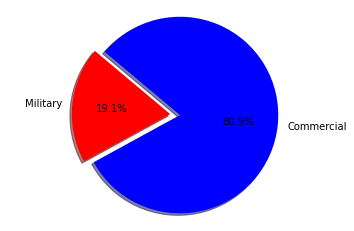

In [125]:
use = ["Military", "Commercial"]
uses = [357, 1514]
colors = ["red","blue"]
explode = (0.1,0)
             
plt.pie(uses, explode=explode, labels=use, colors=colors,
        autopct="%1.1f%%", shadow=True, startangle=140)
# Create axes which are equal so we have a perfect circle
plt.axis("equal")
# Save an image of our chart and print the final product to the screen
plt.savefig("Purpose.png")
plt.show()


In [132]:
#countries with a purpose for earth observation 
earth_observation = cleaned_satellite_df[(cleaned_satellite_df['Purpose'] == 'Earth Observation')]
earth_observation.head(10)
 

,Current Official Name of Satellite,Country/Org of UN Registry,Country of Operator/Owner,Operator/Owner,Users,Purpose,Detailed Purpose,Class of Orbit,Type of Orbit,Longitude of GEO (degrees),Perigee (km),Apogee (km),Eccentricity,Inclination (degrees),Period (minutes),Launch Mass (kg.),Dry Mass (kg.),Power (watts),Date of Launch,Expected Lifetime (yrs.),Contractor,Country of Contractor,Launch Site,Launch Vehicle,COSPAR Number,NORAD Number,Comments,Source Used for Orbital Data,Launch Year
0,1HOPSAT,NR (3/20),USA,Hera Systems,Commercial,Earth Observation,Technology Development,LEO,Non-Polar Inclined,0.0,566,576,0.000720,36.90,96.08,22,NaN,NaN,12/11/2019,0.5,Hera Systems,USA,Satish Dhawan Space Centre,PSLV,2019-089H,44859,Pathfinder for planned earth observation const...,JMSatcat/3_20,2019
3,AAUSat-4,Denmark,Denmark,University of Aalborg,Civil,Earth Observation,Automatic Identification System (AIS),LEO,Sun-Synchronous,0.0,442,687,0.017700,98.20,95.9,1,NaN,NaN,4/25/2016,0.0,University of Aalborg,Denmark,Guiana Space Center,Soyuz 2.1a,2016-025E,41460,Carries AIS system.,Space50,2016
10,USA 139,USA,USA,National Reconnaissance Office (NRO),Military,Earth Observation,Electronic Intelligence,GEO,Unknown,-26.0,"35,560","36,013",0.005370,7.72,1436.14,"4,500",NaN,NaN,5/9/1998,0.0,TRW Space and Electronics,USA,Cape Canaveral,Titan IVA,1998-029A,25336,ELINT.,JM/12_08,1998
11,USA 171,USA,USA,National Reconnaissance Office (NRO),Military,Earth Observation,Electronic Intelligence,GEO,Unknown,95.4,"35,589","35,984",0.004680,3.20,1436.1,"4,500",NaN,NaN,9/9/2003,0.0,TRW Space and Electronics,USA,Cape Canaveral,Titan IV,2003-041A,27937,Electronic intelligence (ELINT).,JM/12_08,2003
12,USA 202,USA,USA,National Reconnaissance Office (NRO),Military,Earth Observation,Electronic Intelligence,GEO,Unknown,44.0,"35,714","35,937",0.002640,2.89,1438.8,"5,000",NaN,NaN,1/18/2009,0.0,National Reconnaissance Laboratory (?),USA,Cape Canaveral,Delta 4 Heavy,2009-001A,33490,ELINT.,SC - ASCR,2009
13,USA 223,USA,USA,National Reconnaissance Office (NRO),Military,Earth Observation,Electronic Intelligence,GEO,Unknown,100.9,"35,500","35,500",0.000000,0.00,1436,"5,000",NaN,NaN,11/21/2010,0.0,National Reconnaissance Laboratory (?),USA,Cape Canaveral,Delta 4 Heavy,2010-063A,37232,ELINT.,SC - ASCR,2010
14,USA 237,USA,USA,National Reconnaissance Office (NRO),Military,Earth Observation,Electronic Intelligence,GEO,Unknown,60.0,"35,771","35,805",0.000403,0.00,1436.1,"5,000",NaN,NaN,6/29/2012,0.0,National Reconnaissance Laboratory (?),USA,Cape Canaveral,Delta 4 Heavy,2012-034A,38528,ELINT.,CalSky,2012
15,USA 268,USA,USA,National Reconnaissance Office (NRO),Military,Earth Observation,Electronic Intelligence,GEO,Unknown,102.6,"35,613","35,903",0.003440,7.51,1437.19,"5,000",NaN,NaN,6/11/2016,0.0,National Reconnaissance Laboratory (?),USA,Cape Canaveral,Delta 4 Heavy,2016-036A,41584,ELINT.,ZARYA,2016
22,Aeolus,ESA,ESA,European Space Agency (ESA),Government,Earth Observation,Earth Science,LEO,Unknown,0.0,314,317,0.000224,96.70,92.4,"1,367",NaN,NaN,8/22/2018,3.0,Airbus Defense and Space,France/UK/Germany/Spain,Guiana Space Center,Vega,2018-066A,43600,Aeolus will precisely measure wind flow and ai...,JMSatcat/11_18,2018
43,AIM,USA,USA,"Center for Atmospheric Sciences, Hampton Unive...",Government,Earth Observation,Earth Science,LEO,Sun-Synchronous,0.0,544,552,0.000578,97.90,96.2,215,197,216,4/25/2007,2.0,Orbital Sciences Corp.,USA,Vandenberg AFB,Pegasus XL,2007-015A,31304,Study noctilucent clouds (NLC) in the polar me...,www.satellitedebris.net 12/12,2007


In [137]:
#countries with earth observing satellites
earth_observation_countries = earth_observation[['Country of Operator/Owner', 'Purpose']]
earth_observation_countries

,Country of Operator/Owner,Purpose
0,USA,Earth Observation
3,Denmark,Earth Observation
10,USA,Earth Observation
11,USA,Earth Observation
12,USA,Earth Observation
13,USA,Earth Observation
14,USA,Earth Observation
15,USA,Earth Observation
22,ESA,Earth Observation
43,USA,Earth Observation


In [139]:
#grouped by country
grouped_earth_observing = earth_observation_countries['Country of Operator/Owner'].value_counts()
grouped_earth_observing

USA                                  352
China                                177
Japan                                 33
Russia                                29
India                                 23
ESA                                   14
Taiwan/USA                            11
Israel                                 9
Argentina                              8
Germany                                8
Italy                                  8
France                                 7
Multinational                          7
United Kingdom                         6
South Korea                            5
Spain                                  5
Canada                                 5
Finland                                4
Saudi Arabia                           4
Turkey                                 3
Algeria                                3
Kazakhstan                             3
Singapore                              3
Philippines                            2
France/Italy/Bel